In [227]:
from collections import defaultdict
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
import nltk
from nltk.tokenize import regexp_tokenize, word_tokenize, RegexpTokenizer
from nltk.corpus import stopwords, wordnet
from nltk import pos_tag
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, plot_confusion_matrix
from sklearn.metrics import classification_report
from nltk.probability import FreqDist
import matplotlib.pyplot as plt
import seaborn as sns
import string
import re
from sklearn.pipeline import Pipeline

%load_ext autoreload
%autoreload 2

import os
import sys
module_path = os.path.abspath(os.pardir)
#print(module_path)
if module_path not in sys.path:
    sys.path.append(module_path)
    


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# 1. EDA and Data Preparation

In this first step, I analyze the tweet data and the various columns within. Some of the pre processing steps include:
- Removing null values within the 'tweet' column
- Renaming columns (features) 
- Making all tweets lower case to be able to prepare visuals and remove certain characters and terms
- Creating a binary features (0 = Negative Emotion and 1 = Positive Emotion) for initial model
- Creating a "company" column to separate products into Google and Apple (for EDA, inferential analysis and potentially, multi class modeling)
- Creating a binary dataframe by dropping tweets with no emotion directed at the brand/product
- Removing hastags and mentions
- Removing words less than 3 characters

In [228]:
df_original = pd.read_excel('./data/judge-1377884607_tweet_product_company.xlsx')

In [229]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9093 entries, 0 to 9092
Data columns (total 3 columns):
 #   Column                                              Non-Null Count  Dtype 
---  ------                                              --------------  ----- 
 0   tweet_text                                          9092 non-null   object
 1   emotion_in_tweet_is_directed_at                     3291 non-null   object
 2   is_there_an_emotion_directed_at_a_brand_or_product  9093 non-null   object
dtypes: object(3)
memory usage: 213.2+ KB


In [230]:
df_original.isnull().sum()

tweet_text                                               1
emotion_in_tweet_is_directed_at                       5802
is_there_an_emotion_directed_at_a_brand_or_product       0
dtype: int64

In [231]:
#create a copy of the df_original to df
df = df_original.copy()
df_original

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
0,".@wesley83 I have a 3G iPhone. After 3 hrs tweeting at #RISE_Austin, it was dead! I need to upgrade. Plugin stations at #SXSW.",iPhone,Negative emotion
1,"@jessedee Know about @fludapp ? Awesome iPad/iPhone app that you'll likely appreciate for its design. Also, they're giving free Ts at #SXSW",iPad or iPhone App,Positive emotion
2,@swonderlin Can not wait for #iPad 2 also. They should sale them down at #SXSW.,iPad,Positive emotion
3,@sxsw I hope this year's festival isn't as crashy as this year's iPhone app. #sxsw,iPad or iPhone App,Negative emotion
4,"@sxtxstate great stuff on Fri #SXSW: Marissa Mayer (Google), Tim O'Reilly (tech books/conferences) &amp; Matt Mullenweg (Wordpress)",Google,Positive emotion
5,@teachntech00 New iPad Apps For #SpeechTherapy And Communication Are Showcased At The #SXSW Conference http://ht.ly/49n4M #iear #edchat #asd,NaN,No emotion toward brand or product
6,NaN,NaN,No emotion toward brand or product
7,"#SXSW is just starting, #CTIA is around the corner and #googleio is only a hop skip and a jump from there, good time to be an #android fan",Android,Positive emotion
8,Beautifully smart and simple idea RT @madebymany @thenextweb wrote about our #hollergram iPad app for #sxsw! http://bit.ly/ieaVOB,iPad or iPhone App,Positive emotion
9,Counting down the days to #sxsw plus strong Canadian dollar means stock up on Apple gear,Apple,Positive emotion


In [232]:
#rename columns so easier to reference
df.rename(columns = {'tweet_text':'tweet', 'emotion_in_tweet_is_directed_at':'product', 'is_there_an_emotion_directed_at_a_brand_or_product':'emotion'}, inplace = True)

In [233]:
#filter on df for all rows that have "NaN" in tweet column and remove it from df
df = df[~pd.isnull(df['tweet'])]
df

,tweet,product,emotion
0,".@wesley83 I have a 3G iPhone. After 3 hrs tweeting at #RISE_Austin, it was dead! I need to upgrade. Plugin stations at #SXSW.",iPhone,Negative emotion
1,"@jessedee Know about @fludapp ? Awesome iPad/iPhone app that you'll likely appreciate for its design. Also, they're giving free Ts at #SXSW",iPad or iPhone App,Positive emotion
2,@swonderlin Can not wait for #iPad 2 also. They should sale them down at #SXSW.,iPad,Positive emotion
3,@sxsw I hope this year's festival isn't as crashy as this year's iPhone app. #sxsw,iPad or iPhone App,Negative emotion
4,"@sxtxstate great stuff on Fri #SXSW: Marissa Mayer (Google), Tim O'Reilly (tech books/conferences) &amp; Matt Mullenweg (Wordpress)",Google,Positive emotion
5,@teachntech00 New iPad Apps For #SpeechTherapy And Communication Are Showcased At The #SXSW Conference http://ht.ly/49n4M #iear #edchat #asd,NaN,No emotion toward brand or product
7,"#SXSW is just starting, #CTIA is around the corner and #googleio is only a hop skip and a jump from there, good time to be an #android fan",Android,Positive emotion
8,Beautifully smart and simple idea RT @madebymany @thenextweb wrote about our #hollergram iPad app for #sxsw! http://bit.ly/ieaVOB,iPad or iPhone App,Positive emotion
9,Counting down the days to #sxsw plus strong Canadian dollar means stock up on Apple gear,Apple,Positive emotion
10,Excited to meet the @samsungmobileus at #sxsw so I can show them my Sprint Galaxy S still running Android 2.1. #fail,Android,Positive emotion


In [234]:
#convert all tweets to lowercase
df['tweet'] = df['tweet'].apply(lambda x: x.lower())

In [235]:
#check counts of each emotion type. This will be the basis of our 'target' for creating the models.
df['emotion'].value_counts()

No emotion toward brand or product    5388
Positive emotion                      2978
Negative emotion                       570
I can't tell                           156
Name: emotion, dtype: int64

In [236]:
#create a 'company' column and assign apple or google to each row based on the product column. I may use this to differentiate between Apple and Google sentiment.
df['company'] = df['product'].apply(lambda x: 'Apple' if x == 'iPad' or x == 'Apple' or x == 'iPad or iPhone App' or x ==  'iPhone' or x == 'Other Apple product or service' else 'Google' if x == 'Google' or x =='Other Google product or service' or x == 'Android App' or x == 'Android' else '')

In [237]:
df_company_nans = df[df['company'] == '']
df_company_nans

,tweet,product,emotion,company
5,@teachntech00 new ipad apps for #speechtherapy and communication are showcased at the #sxsw conference http://ht.ly/49n4m #iear #edchat #asd,NaN,No emotion toward brand or product,
16,holler gram for ipad on the itunes app store - http://t.co/kfn3f5q (via @marc_is_ken) #sxsw,NaN,No emotion toward brand or product,
32,"attn: all #sxsw frineds, @mention register for #gdgtlive and see cobra iradar for android. {link}",NaN,No emotion toward brand or product,
33,anyone at #sxsw want to sell their old ipad?,NaN,No emotion toward brand or product,
34,anyone at #sxsw who bought the new ipad want to sell their older ipad to me?,NaN,No emotion toward brand or product,
35,"at #sxsw. oooh. rt @mention google to launch major new social network called circles, possibly today {link}",NaN,No emotion toward brand or product,
37,spin play - a new concept in music discovery for your ipad from @mention &amp; spin.com {link} #itunes #sxsw @mention,NaN,No emotion toward brand or product,
39,vatornews - google and apple force print media to evolve? {link} #sxsw,NaN,No emotion toward brand or product,
41,"hootsuite - hootsuite mobile for #sxsw ~ updates for iphone, blackberry &amp; android: whether you‰ûªre getting friend... {link}",NaN,No emotion toward brand or product,
42,hey #sxsw - how long do you think it takes us to make an iphone case? answer @mention using #zazzlesxsw and we‰ûªll make you one!,NaN,No emotion toward brand or product,


In [238]:
import string 
def remove_punctuation(text):
    for punctuation in string.punctuation:
        text = text.replace(punctuation, ' ')
    return text

df_company_nans['tweet'] = df_company_nans['tweet'].apply(remove_punctuation)

<ipython-input-238-a5a2fe2cea79>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_company_nans['tweet'] = df_company_nans['tweet'].apply(remove_punctuation)


In [239]:
#find the associated products for apple and google and then update 'company' column
applesearch=['apple','ipad','iphone','apples','ipads','iphones']
googlesearch=['google','android','googles','androids']

df_company_nans['company'] = ['Google' if any(word in x.split() for word in googlesearch) == True else 'Apple' if any(word in x.split() for word in applesearch) == True else 'na' for x in df_company_nans['tweet']]

df_company_nans 

<ipython-input-239-b69a05b60332>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_company_nans['company'] = ['Google' if any(word in x.split() for word in googlesearch) == True else 'Apple' if any(word in x.split() for word in applesearch) == True else 'na' for x in df_company_nans['tweet']]


,tweet,product,emotion,company
5,teachntech00 new ipad apps for speechtherapy and communication are showcased at the sxsw conference http ht ly 49n4m iear edchat asd,NaN,No emotion toward brand or product,Apple
16,holler gram for ipad on the itunes app store http t co kfn3f5q via marc is ken sxsw,NaN,No emotion toward brand or product,Apple
32,attn all sxsw frineds mention register for gdgtlive and see cobra iradar for android link,NaN,No emotion toward brand or product,Google
33,anyone at sxsw want to sell their old ipad,NaN,No emotion toward brand or product,Apple
34,anyone at sxsw who bought the new ipad want to sell their older ipad to me,NaN,No emotion toward brand or product,Apple
35,at sxsw oooh rt mention google to launch major new social network called circles possibly today link,NaN,No emotion toward brand or product,Google
37,spin play a new concept in music discovery for your ipad from mention amp spin com link itunes sxsw mention,NaN,No emotion toward brand or product,Apple
39,vatornews google and apple force print media to evolve link sxsw,NaN,No emotion toward brand or product,Google
41,hootsuite hootsuite mobile for sxsw updates for iphone blackberry amp android whether you‰ûªre getting friend link,NaN,No emotion toward brand or product,Google
42,hey sxsw how long do you think it takes us to make an iphone case answer mention using zazzlesxsw and we‰ûªll make you one,NaN,No emotion toward brand or product,Apple


In [240]:
df_company_nans = pd.DataFrame(df_company_nans['company'])
df_company_nans.value_counts()

company
Apple      2919
Google     2088
na          794
dtype: int64

In [241]:
dfmerge = df.join(df_company_nans,rsuffix='2')
dfmerge.loc[dfmerge['company'] == '','company'] = dfmerge["company2"]
df = dfmerge.drop(columns = 'company2')

In [242]:
#see updated count of company related tweets based on extracting related terms
df['company'].value_counts()

Apple     5328
Google    2970
na         794
Name: company, dtype: int64

In [243]:

#create binary class if positive emotion then 1 and negative emotion is 0. No emotion is assigned 2 for now, but will be removed for testing.
df['binary_emotion']=df['emotion'].apply(lambda x: 1 if x == 'Positive emotion' else 0 if x == 'Negative emotion' else 2)

df['class_emotion']=df['emotion'].apply(lambda x: 0 if x == 'No emotion toward brand or product' else 1 if x == 'Positive emotion' else 2 if x == 'Negative emotion' else 3)



In [244]:
#remove the 'I can't tell' from the dataframe
df = df[~(df['class_emotion'] == 3)]
df

,tweet,product,emotion,company,binary_emotion,class_emotion
0,".@wesley83 i have a 3g iphone. after 3 hrs tweeting at #rise_austin, it was dead! i need to upgrade. plugin stations at #sxsw.",iPhone,Negative emotion,Apple,0,2
1,"@jessedee know about @fludapp ? awesome ipad/iphone app that you'll likely appreciate for its design. also, they're giving free ts at #sxsw",iPad or iPhone App,Positive emotion,Apple,1,1
2,@swonderlin can not wait for #ipad 2 also. they should sale them down at #sxsw.,iPad,Positive emotion,Apple,1,1
3,@sxsw i hope this year's festival isn't as crashy as this year's iphone app. #sxsw,iPad or iPhone App,Negative emotion,Apple,0,2
4,"@sxtxstate great stuff on fri #sxsw: marissa mayer (google), tim o'reilly (tech books/conferences) &amp; matt mullenweg (wordpress)",Google,Positive emotion,Google,1,1
5,@teachntech00 new ipad apps for #speechtherapy and communication are showcased at the #sxsw conference http://ht.ly/49n4m #iear #edchat #asd,NaN,No emotion toward brand or product,Apple,2,0
7,"#sxsw is just starting, #ctia is around the corner and #googleio is only a hop skip and a jump from there, good time to be an #android fan",Android,Positive emotion,Google,1,1
8,beautifully smart and simple idea rt @madebymany @thenextweb wrote about our #hollergram ipad app for #sxsw! http://bit.ly/ieavob,iPad or iPhone App,Positive emotion,Apple,1,1
9,counting down the days to #sxsw plus strong canadian dollar means stock up on apple gear,Apple,Positive emotion,Apple,1,1
10,excited to meet the @samsungmobileus at #sxsw so i can show them my sprint galaxy s still running android 2.1. #fail,Android,Positive emotion,Google,1,1


In [19]:
def company_emotion(row):
#     if row['class_emotion'] == 0 and row['company'] == 'Google':
#         return 'No Emotion Google'
    
#     elif row['class_emotion'] == 0 and row['company'] == 'Apple':
#         return 'No Emotion Apple'

#     elif row['class_emotion'] == 1 and row['company'] == 'Google':
#         return 'Positive Emotion Google'

#     elif row['class_emotion'] == 1 and row['company'] == 'Apple':
#         return 'Positive Emotion Applie'

#     elif
    
    if row['class_emotion'] == 2 and row['company'] == 'Google':
        return 'Negative Emotion Google'

    elif row['class_emotion'] == 2 and row['company'] == 'Apple':
        return 'Negative Emotion Apple'
    
    else:
        return 'All other'
    
df['class_company_emotion']=df.apply(lambda row: company_emotion(row), axis=1)

In [20]:
df

,tweet,product,emotion,company,binary_emotion,class_emotion,class_company_emotion
0,.@wesley83 i have a 3g iphone. after 3 hrs twe...,iPhone,Negative emotion,Apple,0,2,Negative Emotion Apple
1,@jessedee know about @fludapp ? awesome ipad/i...,iPad or iPhone App,Positive emotion,Apple,1,1,All other
2,@swonderlin can not wait for #ipad 2 also. the...,iPad,Positive emotion,Apple,1,1,All other
3,@sxsw i hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion,Apple,0,2,Negative Emotion Apple
4,@sxtxstate great stuff on fri #sxsw: marissa m...,Google,Positive emotion,Google,1,1,All other
...,...,...,...,...,...,...,...
9088,ipad everywhere. #sxsw {link},iPad,Positive emotion,Apple,1,1,All other
9089,"wave, buzz... rt @mention we interrupt your re...",NaN,No emotion toward brand or product,Google,2,0,All other
9090,"google's zeiger, a physician never reported po...",NaN,No emotion toward brand or product,Google,2,0,All other
9091,some verizon iphone customers complained their...,NaN,No emotion toward brand or product,Apple,2,0,All other


In [21]:
#Courtesy of Garret Hall. Remove hashtags and mentions from tweets.

def clean_hash_mentions(tweet):
    # pattern to remove hashtags and mentions
    hashtag_mention_pattern = '([@#][\w_-]+)'
    
    # remove hashtags and mentions
    tweet_clean = re.sub(hashtag_mention_pattern, '', tweet)
    
    # lower case
    tweet_clean = tweet_clean.lower()
    
    # tokenize tweet
    pattern = "([a-zA-Z0-9]+(?:'[a-z]+)?)"
    tweet_clean = nltk.regexp_tokenize(tweet_clean, pattern)
    
    # join tweet back together
    tweet_clean = ' '.join(tweet_clean)

    return tweet_clean

In [22]:
#apply the function to the "tweet" column and create a new "clean_tweet" column, which will be the basis for our X variable
df['clean_tweet'] = [clean_hash_mentions(tweet) for tweet in df['tweet']]
df

,tweet,product,emotion,company,binary_emotion,class_emotion,class_company_emotion,clean_tweet
0,.@wesley83 i have a 3g iphone. after 3 hrs twe...,iPhone,Negative emotion,Apple,0,2,Negative Emotion Apple,i have a 3g iphone after 3 hrs tweeting at it ...
1,@jessedee know about @fludapp ? awesome ipad/i...,iPad or iPhone App,Positive emotion,Apple,1,1,All other,know about awesome ipad iphone app that you'll...
2,@swonderlin can not wait for #ipad 2 also. the...,iPad,Positive emotion,Apple,1,1,All other,can not wait for 2 also they should sale them ...
3,@sxsw i hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion,Apple,0,2,Negative Emotion Apple,i hope this year's festival isn't as crashy as...
4,@sxtxstate great stuff on fri #sxsw: marissa m...,Google,Positive emotion,Google,1,1,All other,great stuff on fri marissa mayer google tim o'...
...,...,...,...,...,...,...,...,...
9088,ipad everywhere. #sxsw {link},iPad,Positive emotion,Apple,1,1,All other,ipad everywhere link
9089,"wave, buzz... rt @mention we interrupt your re...",NaN,No emotion toward brand or product,Google,2,0,All other,wave buzz rt we interrupt your regularly sched...
9090,"google's zeiger, a physician never reported po...",NaN,No emotion toward brand or product,Google,2,0,All other,google's zeiger a physician never reported pot...
9091,some verizon iphone customers complained their...,NaN,No emotion toward brand or product,Apple,2,0,All other,some verizon iphone customers complained their...


In [23]:
df['binary_emotion'].value_counts()

2    5388
1    2978
0     570
Name: binary_emotion, dtype: int64

We can see that of all the emotions assigned, ~5,400 do not have any emotion indicated from the tweet

In [24]:
#after initial modeling attempt, I decided to remove common words or phrases such as 'rt' (retweet) and 'link'
df['clean_tweet'] = df['clean_tweet'].map(lambda x: x.replace('rt',''))
df['clean_tweet'] = df['clean_tweet'].map(lambda x: x.replace('link',''))
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8936 entries, 0 to 9092
Data columns (total 8 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   tweet                  8936 non-null   object
 1   product                3282 non-null   object
 2   emotion                8936 non-null   object
 3   company                8936 non-null   object
 4   binary_emotion         8936 non-null   int64 
 5   class_emotion          8936 non-null   int64 
 6   class_company_emotion  8936 non-null   object
 7   clean_tweet            8936 non-null   object
dtypes: int64(2), object(6)
memory usage: 628.3+ KB


In [25]:
#identify and drop duplicates. After removing 'rt' and 'link' and hashtags/mentions, there are some duplicate tweets 
#in the clean tweet column with varying emotions assigned.
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
df.loc[df.duplicated(subset='clean_tweet',keep=False)].sort_values(by='clean_tweet')

,tweet,product,emotion,company,binary_emotion,class_emotion,class_company_emotion,clean_tweet
7346,#sxsw #japan #sendai #prayforjapan #beforetwitter #ipad #tiesto #hotel #airplane #food,NaN,No emotion toward brand or product,Apple,2,0,All other,
1561,@mention @mention $ #tweethouse #ipad #sxsw #dotco,NaN,No emotion toward brand or product,Apple,2,0,All other,
1700,@mention #sxsw #apple #ipad2 {link},NaN,No emotion toward brand or product,Apple,2,0,All other,
5025,rt @mention,NaN,No emotion toward brand or product,na,2,0,All other,
7369,{link} #iphone #kneejockey #ftw #sxsw,NaN,No emotion toward brand or product,Apple,2,0,All other,
1469,‰÷¼ ????????? ‰÷_ {link} ‰ã_ #edchat #musedchat #sxsw #sxswi #classical #newtwitter,NaN,No emotion toward brand or product,na,2,0,All other,
1470,‰÷¼ ????????? ‰÷_ {link} ‰ã_ #edchat #musedchat #sxsw #sxswi #classical #newtwitter rt @mention,NaN,No emotion toward brand or product,na,2,0,All other,
5332,rt @mention ‰÷¼ ????????? ‰÷_ {link} ‰ã_ #edchat #musedchat #sxsw #sxswi #classical #newtwitter,NaN,No emotion toward brand or product,na,2,0,All other,
6518,rt @mention rt @mention best thing i've heard this weekend at #sxsw &quot;i gave my ipad 2 money to #japan relief. i don't need an ipad 2.&quot; @mention,NaN,No emotion toward brand or product,Apple,2,0,All other,best thing i've heard this weekend at quot i gave my ipad 2 money to relief i don't need an ipad 2 quot
6517,rt @mention rt @mention best thing i've heard this weekend at #sxsw &quot;i gave my ipad 2 money to #japan relief. i don't need an ipad 2.&quot; (@mention,iPad,No emotion toward brand or product,Apple,2,0,All other,best thing i've heard this weekend at quot i gave my ipad 2 money to relief i don't need an ipad 2 quot


In [26]:
df.drop_duplicates(subset='clean_tweet',keep=False,inplace=True)

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8248 entries, 5 to 9092
Data columns (total 8 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   tweet                  8248 non-null   object
 1   product                3084 non-null   object
 2   emotion                8248 non-null   object
 3   company                8248 non-null   object
 4   binary_emotion         8248 non-null   int64 
 5   class_emotion          8248 non-null   int64 
 6   class_company_emotion  8248 non-null   object
 7   clean_tweet            8248 non-null   object
dtypes: int64(2), object(6)
memory usage: 579.9+ KB


After dropping duplicates, we are down to 8,248 tweets/records

In [28]:
#instantiate stopwords and save to 'sw'
sw = stopwords.words('english')

Here, I created a 'tweet_preparer' function that will be used to tokenize the 'clean_tweet' column for each model.

In [29]:
def tweet_preparer(tweet, stop_words=sw):
    regex_token = RegexpTokenizer(r"([a-zA-Z]+(?:’[a-z]+)?)")
    tweet = regex_token.tokenize(tweet)
    tweet_lower = [word.lower() for word in tweet]
    tweet = [word for word in tweet_lower if word not in sw]
    lemmatizer = WordNetLemmatizer() 
    tweet = [lemmatizer.lemmatize(word) for word in tweet]
    tweet = [word for word in tweet if len(word) > 2]  #remove 'words' that are less than 3 characters
    
    return ' '.join(tweet)

For EDA purposes, I will analyze the list of words within the clean_tweet column and use a frequency distribution line graph.

In [30]:
token_eda = [tweet_preparer(tweet, sw) for tweet in df['clean_tweet']]
token_eda

['new ipad apps communication showcased conference http',
 'beautifully sma simple idea wrote ipad app http bit ieavob',
 'find amp sta impromptu pay http bit gvlrin wait til android app come',
 'foursquare ups game time http grn still prefer far best looking android app date',
 'gotta love google calendar featuring top pay show case check via http bit axzwxb',
 'great ipad app http tinyurl com nqv',
 'haha awesomely rad ipad app http bit htdfim',
 'holler gram ipad itunes app store http kfn via',
 'must app lovely review forbes sxsw ipad app holler gram http gzypv',
 'photo installed iphone app really nice http tumblr com',
 'haha awesomely rad ipad app http bit htdfim via',
 'new look like going rock update iphone android push tonight http bit etsbzk',
 'sma ipad app http xvwc may leave vuvuzela home',
 'must app ipad going http itunes apple com app holler gram',
 'attn frineds register see cobra iradar android',
 'anyone want sell old ipad',
 'anyone bought new ipad want sell older 

In [31]:
list_of_words = []
for tweet in token_eda:
    for word in tweet.split():
        list_of_words.append(word)

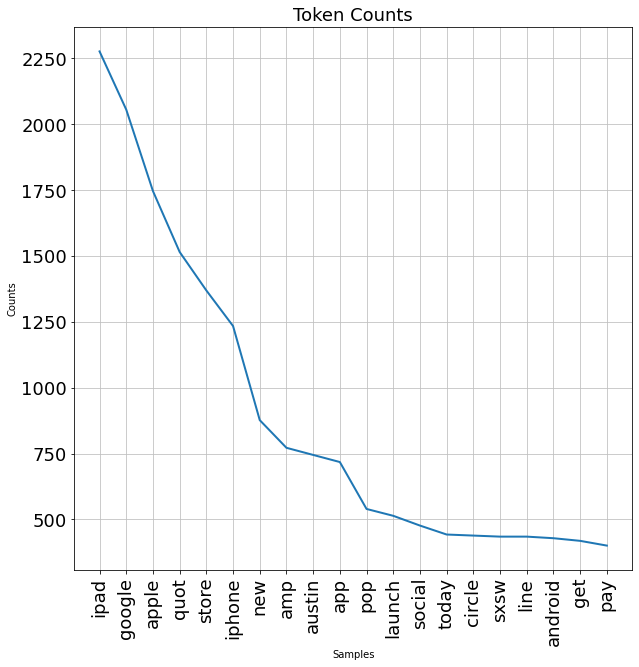

In [32]:
fdist = FreqDist(list_of_words)
plt.figure(figsize = (10,10))


# Labels, title and ticks


plt.xticks(fontsize=18)
plt.yticks(fontsize=18)

plt.title("Token Counts",fontsize=18 )

plt.ylabel("Count")
plt.xlabel("Token")

fdist.plot(20)

plt.savefig('WordGraph.png')
plt.show()

In [33]:
df['count'] = 1

[Text(0.5, 1.0, 'Count of tweets by Emotion Type and Company')]

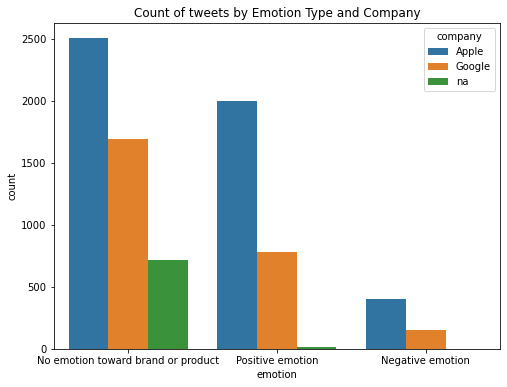

In [34]:
plt.figure(figsize=(8, 6))
ax = sns.barplot(x=df['emotion'],y=df['count'],hue=df['company'], estimator=sum)

ax.set(title='Count of tweets by Emotion Type and Company')
plt.savefig('bargraph_of_tweets.png')

# 2. Create Cross Validation Class and Pipeline function

Next, I used the ModelWithCV() class below (Flatiron lecture #51) and create Pipeline function to apply each of the different vectorizer and model combinations. Each pipeline is a combination of either CountVectorizer or TFIDFVectorizer and certain classifiers (dummy, decisiontree, multinomial, and KNN). The function returns the mean CV (cross validation) score based on the ModelWithCV() class.

In [35]:
class ModelWithCV():   #from flatiron lecture 51
    '''Structure to save the model and more easily see its crossvalidation'''
    def __init__(self, model, model_name, X, y, cv_now=True):
        self.model = model
        self.name = model_name
        self.X = X
        self.y = y
        # For CV results
        self.cv_results = None
        self.cv_mean = None
        self.cv_median = None
        self.cv_std = None
        #
        if cv_now:
            self.cross_validate()
        
    def cross_validate(self, X=None, y=None, kfolds=10):
        '''
        Perform cross-validation and return results.
        
        Args: 
          X:
            Optional; Training data to perform CV on. Otherwise use X from object
          y:
            Optional; Training data to perform CV on. Otherwise use y from object
          kfolds:
            Optional; Number of folds for CV (default is 10)  
        '''
        
        cv_X = X if X else self.X
        cv_y = y if y else self.y

        self.cv_results = cross_val_score(self.model, cv_X, cv_y, cv=kfolds)
        self.cv_mean = np.mean(self.cv_results)
        self.cv_median = np.median(self.cv_results)
        self.cv_std = np.std(self.cv_results)

        
    def print_cv_summary(self):
        cv_summary = (
        f'''CV Results for `{self.name}` model:
            {self.cv_mean:.5f} ± {self.cv_std:.5f} accuracy
        ''')
        print(cv_summary)
    
    def cvmean(self):
        cvmean2 = round(self.cv_mean,3)
        print(cvmean2)

In [36]:
def run_pipelines_cv(xtrain,ytrain):
#countvectorizer with MNB and 

    
    cv_dummy_model_pipe = Pipeline(steps= [
    ('cv',CountVectorizer()),
    ('dum', DummyClassifier(strategy = 'most_frequent'))
])

    cv_dt_model_pipe = Pipeline(steps= [
    ('cv',CountVectorizer()),
    ('dt', DecisionTreeClassifier())
])

    cv_mnb_model_pipe = Pipeline([
    ('cv',CountVectorizer()),
    ('mnb',MultinomialNB())
])

    cv_rf_model_pipe = Pipeline([
    ('cv',CountVectorizer()),
    ('rf',RandomForestClassifier())
])

    cv_knn_model_pipe = Pipeline([
    ('cv',CountVectorizer()),
    ('knn',KNeighborsClassifier())
])
    
    tfidf_dummy_model_pipe = Pipeline(steps= [
    ('tfidf',TfidfVectorizer()),
    ('dum', DummyClassifier(strategy = 'most_frequent'))
])
    
    tfidf_dt_model_pipe = Pipeline(steps= [
    ('tfidf',TfidfVectorizer()),
    ('dt', DecisionTreeClassifier())
])
    
    tfidf_mnb_model_pipe = Pipeline([
    ('tfidf',TfidfVectorizer()),
    ('mnb',MultinomialNB())
])

    tfidf_rf_model_pipe = Pipeline([
    ('tfidf',TfidfVectorizer()),
    ('rf',RandomForestClassifier())
])

    tfidf_knn_model_pipe = Pipeline([
    ('tfidf',TfidfVectorizer()),
    ('knn',KNeighborsClassifier())
])

    
    cv_dummy_pipe = ModelWithCV(cv_dummy_model_pipe, 'cv_dummy_model', xtrain, ytrain)
    cv_dt_pipe = ModelWithCV(cv_dt_model_pipe, 'cv_dt_model', xtrain, ytrain)
    cv_mnb_pipe = ModelWithCV(cv_mnb_model_pipe,'cv_mnb_model', xtrain, ytrain)
    cv_rf_pipe = ModelWithCV(cv_rf_model_pipe,'cv_rf_model', xtrain, ytrain)
    cv_knn_pipe = ModelWithCV(cv_knn_model_pipe,'cv_knn_model', xtrain, ytrain)
    
    tfidf_dummy_pipe = ModelWithCV(tfidf_dummy_model_pipe, 'tfidf_dummy_model', xtrain, ytrain)
    tfidf_dt_pipe = ModelWithCV(tfidf_dt_model_pipe, 'tfidf_dt_model', xtrain, ytrain)
    tfidf_mnb_pipe = ModelWithCV(tfidf_mnb_model_pipe,'tfidf_mnb_model', xtrain, ytrain)
    tfidf_rf_pipe = ModelWithCV(tfidf_rf_model_pipe,'tfidf_rf_model', xtrain, ytrain)
    tfidf_knn_pipe = ModelWithCV(tfidf_knn_model_pipe,'tfidf_knn_model', xtrain, ytrain)
    
    print (cv_dummy_pipe.print_cv_summary(),
    cv_dt_pipe.print_cv_summary(),
    cv_mnb_pipe.print_cv_summary(),
    cv_rf_pipe.print_cv_summary(),
    cv_knn_pipe.print_cv_summary(), 
    tfidf_dummy_pipe.print_cv_summary(),
    tfidf_dt_pipe.print_cv_summary(), 
    tfidf_mnb_pipe.print_cv_summary(),
    tfidf_rf_pipe.print_cv_summary(),
    tfidf_knn_pipe.print_cv_summary())
   

# 2. Initial NLP Model - Binary Classification (Positive and Negative)

Now, we will assign the target (Positive = 0 and Negative = 1 emotion) and variables (token data from tweets) from the df_binary dataframe to X and Y respectively, and identify the most successful predictive model after applying cross validation and grid searches.

In [86]:
df_binary = df[~(df['binary_emotion'] == 2)]
df_binary['binary_emotion'].value_counts()


1    2787
0     553
Name: binary_emotion, dtype: int64

In [87]:
X = df_binary['clean_tweet']
y = df_binary['binary_emotion']

In [88]:
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    random_state=42,
                                                    test_size=0.25)

In [89]:
#tokenize the clean_tweet data
X_train_tokenized = [tweet_preparer(tweet, sw) for tweet in X_train]
X_train_tokenized

['love new ipad seems much faster fluid original seems natural hold excited use week',
 'yes google pay glowing cup',
 'sma ipad app may leave vuvuzela home',
 'giving away ipad sharer invite friend join aos ginger man',
 'aicle good ing iphone train',
 'winner awesome got ipad via',
 'found bbq sauce ipad tech texas really come together',
 'free android tshi',
 'google body beta uber',
 'might need apple today think quot quot quot quot quot quot key worn',
 'cool latest version google map mobile building sure mapped detail yet',
 'jealous team event get swag girl',
 'meeting line popup apple store ipad love place',
 'congrats awesome ipad lounge experience complete',
 'million mobile user google map google map usage mobile device',
 'whoa google launch major new social network called circle possibly today',
 'google talking quot topicality reputation quot search ranking sure saw bing writing note',
 'genius move apple open temp store downtown austin via',
 'google launch major new soc

In [41]:
run_pipelines_cv(X_train_tokenized, y_train)

CV Results for `cv_dummy_model` model:
            0.83433 ± 0.00167 accuracy
        
CV Results for `cv_dt_model` model:
            0.85111 ± 0.01554 accuracy
        
CV Results for `cv_mnb_model` model:
            0.85948 ± 0.00837 accuracy
        
CV Results for `cv_rf_model` model:
            0.86986 ± 0.01064 accuracy
        
CV Results for `cv_knn_model` model:
            0.84511 ± 0.01494 accuracy
        
CV Results for `tfidf_dummy_model` model:
            0.83433 ± 0.00167 accuracy
        
CV Results for `tfidf_dt_model` model:
            0.83553 ± 0.02006 accuracy
        
CV Results for `tfidf_mnb_model` model:
            0.84432 ± 0.00486 accuracy
        
CV Results for `tfidf_rf_model` model:
            0.87026 ± 0.00743 accuracy
        
CV Results for `tfidf_knn_model` model:
            0.85110 ± 0.01212 accuracy
        
None None None None None None None None None None


Based on the results above, the most successful vectorizer and model for this particular prediction are:
  1. tfidf_rf_model
  2. cv_rf_model
  3. cv_mnb_model
    

### Apply Grid Search and Identify Best Score and Best Parameters  

In [42]:
 def run_gridsearch(xtrain,ytrain):

    cv_rf_model_pipe = Pipeline([
    ('cv',CountVectorizer()),
    ('rf',RandomForestClassifier())
])
    

    tfidf_rf_model_pipe = Pipeline([
    ('tfidf',TfidfVectorizer()),
    ('rf',RandomForestClassifier())
])
    

    cv_mnb_model_pipe = Pipeline([
    ('cv',CountVectorizer()),
    ('mnb',MultinomialNB())
])
    
    parameter_cv_rf = {
     'cv__max_df':[.5,.7,.9],
     'cv__max_features': [None,200,400,1000],
     'cv__ngram_range':[(1,1),(1,2)],
        'rf__criterion': ['gini', 'entropy'],
        'rf__min_samples_leaf': [1, 5, 10],
        'rf__max_depth': [None, 5, 7, 9]
}


    parameter_tfidf_rf = {
     'tfidf__use_idf':[True,False],
     'tfidf__norm':['l1','l2'],
        'rf__criterion': ['gini', 'entropy'],
        'rf__min_samples_leaf': [1, 5, 10],
        'rf__max_depth': [None, 5, 7, 9]
}
   
   
    parameter_cv_mnb = {
     'cv__max_df':[.5,.7,.9],
     'cv__max_features': [None,200,400,1000],
     'cv__ngram_range':[(1,1),(1,2)],
        'mnb__alpha': [.3, .7, 1]
}

  
        
    gs_cv_rf = GridSearchCV(cv_rf_model_pipe, parameter_cv_rf, cv=5)
    gs_cv_rf.fit(xtrain, ytrain)
    
    gs_cv_mnb = GridSearchCV(cv_mnb_model_pipe, parameter_cv_mnb, cv=5)
    gs_cv_mnb.fit(xtrain, ytrain)
    
    gs_tfidf_rf = GridSearchCV(tfidf_rf_model_pipe, parameter_tfidf_rf)
    gs_tfidf_rf.fit(xtrain, ytrain)
    
    
    print(f'cv_rf: {gs_cv_rf.best_params_} {gs_cv_rf.best_score_}')
    print(f'cv_mnb:  {gs_cv_mnb.best_params_} {gs_cv_mnb.best_score_}')
    print(f'tfidf_rf: {gs_tfidf_rf.best_params_} {gs_tfidf_rf.best_score_}')

In [43]:
 run_gridsearch(X_train_tokenized, y_train)

cv_rf: {'cv__max_df': 0.9, 'cv__max_features': None, 'cv__ngram_range': (1, 1), 'rf__criterion': 'entropy', 'rf__max_depth': None, 'rf__min_samples_leaf': 1} 0.8674650698602795
cv_mnb:  {'cv__max_df': 0.5, 'cv__max_features': None, 'cv__ngram_range': (1, 2), 'mnb__alpha': 0.7} 0.8674650698602793
tfidf_rf: {'rf__criterion': 'entropy', 'rf__max_depth': None, 'rf__min_samples_leaf': 1, 'tfidf__norm': 'l2', 'tfidf__use_idf': False} 0.8662674650698603


Based on the results of the grid searches applied above, the cv_mnb model with a best accuracy score of .867 is the final model for this binary prediction.

### Final Binary NLP Model (Positive or Negative)

In [90]:
#Apply the best params to the vectorizer and chosen model 

cv = CountVectorizer(max_df= 0.5, max_features = None, ngram_range= (1, 2))
X_train_vec = cv.fit_transform(X_train_tokenized)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(cv.vocabulary_)
X_train_vec.set_index(y_train.index, inplace=True)


X_test_tokens = [tweet_preparer(tweet, sw) for tweet in X_test]
X_test_tokens_vec = cv.transform(X_test_tokens)
X_test_vec  = pd.DataFrame.sparse.from_spmatrix(X_test_tokens_vec)
X_test_vec.columns = sorted(cv.vocabulary_)
X_test_vec.set_index(y_test.index, inplace=True)

mnb = MultinomialNB()
mnb.fit(X_train_vec, y_train)


y_train_hat = mnb.predict(X_train_vec)
y_test_hat = mnb.predict(X_test_tokens_vec)

accuracy_score(y_test, y_test_hat)

0.8646706586826347

In [91]:
print('y_test:' + classification_report(y_test, y_test_hat))

y_test:              precision    recall  f1-score   support

           0       0.82      0.23      0.36       138
           1       0.87      0.99      0.92       697

    accuracy                           0.86       835
   macro avg       0.84      0.61      0.64       835
weighted avg       0.86      0.86      0.83       835



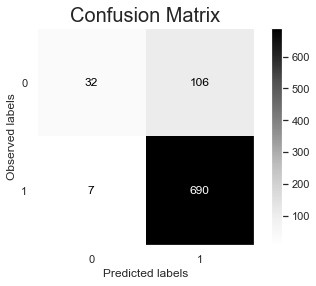

In [92]:
#Plot a confusion matric on actual and preditions of the test data.
ax = plt.subplot()
sns.set(font_scale=1) # Adjust to fit

plot_confusion_matrix(mnb, X_test_tokens_vec, y_test, ax=ax,  cmap = plt.cm.Greys)

# Labels, title and ticks
label_font = {'size':'12'}  # Adjust to fit
ax.set_xlabel('Predicted labels', fontdict=label_font);
ax.set_ylabel('Observed labels', fontdict=label_font);
ax.grid(b=False);

title_font = {'size':'20'}  # Adjust to fit
ax.set_title('Confusion Matrix', fontdict=title_font);

plt.savefig('ConfusionMatrix_Binary.png')

plt.show()

In [ ]:
#if rf model is select, can order feature importances

# importances = sorted(list(zip(rf.feature_importances_,tfidf.get_feature_names())))[-20:]
# impts = pd.DataFrame(importances, columns=['impt','feature'])
# plt.barh(impts.feature,impts.impt);

# 3. NLP Model - Multi Classification (Positive, Negative and None)

In this model, I add back the "none" category to the emotion column, and will attempt to build out a predictive model. No emotion was the most common emotion type within the data, so including will be critical to the success of a useful model.

In [93]:
df['emotion'].value_counts()

No emotion toward brand or product    4908
Positive emotion                      2787
Negative emotion                       553
Name: emotion, dtype: int64

In [94]:
X2 = df['clean_tweet']
y2 = df['emotion']

In [95]:
X_train, X_test, y_train, y_test = train_test_split(X2,
                                                    y2,
                                                    random_state=42,
                                                    test_size=0.25)

In [96]:
X_train_tokenized2 = [tweet_preparer(tweet, sw) for tweet in X_train]
X_train_tokenized2


['loved hangover breakfast awesome swag yummy food amp rockin tune stoked griffin cordless iphone charger',
 'convention center getting stuff ready thank god iphone',
 'helping clean organize news content great job owner',
 'lightbox want new',
 'day google map saving two year user life',
 'jealous see people ipad take photo',
 'know maybe going gary talk wish could iphone clip',
 'get pop apple store ipad complete foursquare badge list',
 'one fav photo far amp',
 'diller google quot first product good consumer product basically quot',
 'interesting google mobile stats google map user million come',
 'line front quot secret quot apple ipad store congress ave long line sbux longer',
 'google apple game zynga facebook microsoft intuit went gaga game',
 'coming social network mean working something though',
 'austin',
 'dancing google pay truth need girl joint',
 'google circle stress context sharing everyone',
 'public service announcement grill amazing drink food free great company zaz

In [52]:
run_pipelines_cv(X_train_tokenized2, y_train)

CV Results for `cv_dummy_model` model:
            0.59101 ± 0.00116 accuracy
        
CV Results for `cv_dt_model` model:
            0.63481 ± 0.02413 accuracy
        
CV Results for `cv_mnb_model` model:
            0.66472 ± 0.01403 accuracy
        
CV Results for `cv_rf_model` model:
            0.67119 ± 0.01486 accuracy
        
CV Results for `cv_knn_model` model:
            0.61171 ± 0.01339 accuracy
        
CV Results for `tfidf_dummy_model` model:
            0.59101 ± 0.00116 accuracy
        
CV Results for `tfidf_dt_model` model:
            0.62625 ± 0.01839 accuracy
        
CV Results for `tfidf_mnb_model` model:
            0.64419 ± 0.01426 accuracy
        
CV Results for `tfidf_rf_model` model:
            0.67022 ± 0.01009 accuracy
        
CV Results for `tfidf_knn_model` model:
            0.61946 ± 0.01622 accuracy
        
None None None None None None None None None None


Based on the results above, the most successful vectorizer and model for this particular prediction are that same as our initial binary model.

1. cv_mnb_model
2. tfidf_rf_model
3. cv_rf_model
 

### Apply Grid Search and Identify Best Score and Best Parameters  

In [53]:
 run_gridsearch(X_train_tokenized2, y_train)

cv_rf: {'cv__max_df': 0.7, 'cv__max_features': None, 'cv__ngram_range': (1, 1), 'rf__criterion': 'gini', 'rf__max_depth': None, 'rf__min_samples_leaf': 1} 0.6653746948882269
cv_mnb:  {'cv__max_df': 0.5, 'cv__max_features': None, 'cv__ngram_range': (1, 2), 'mnb__alpha': 1} 0.6580990279520911
tfidf_rf: {'rf__criterion': 'gini', 'rf__max_depth': None, 'rf__min_samples_leaf': 1, 'tfidf__norm': 'l2', 'tfidf__use_idf': True} 0.666182057534057


Based on the results of the grid searches applied above, the tfidf_rf model with a best accuracy score of .67 is the final model for this multi-class (3) prediction.

### Final Multi Class (3) NLP Model

In [97]:
tfidf = TfidfVectorizer(norm = 'l2', use_idf =False)
X_train_vec = tfidf.fit_transform(X_train_tokenized2)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(tfidf.vocabulary_)
X_train_vec.set_index(y_train.index, inplace=True)


X_test_tokens = [tweet_preparer(tweet, sw) for tweet in X_test]
X_test_tokens_vec = tfidf.transform(X_test_tokens)
X_test_vec  = pd.DataFrame.sparse.from_spmatrix(X_test_tokens_vec)
X_test_vec.columns = sorted(tfidf.vocabulary_)
X_test_vec.set_index(y_test.index, inplace=True)


rf = RandomForestClassifier(criterion='gini',min_samples_leaf = 1)
rf.fit(X_train_vec, y_train)

y_train_hat = rf.predict(X_train_vec)
y_test_hat = rf.predict(X_test_tokens_vec)

accuracy_score(y_test, y_test_hat)

0.6896217264791464

In [98]:
print('y_test:' + classification_report(y_test, y_test_hat))

y_test:                                    precision    recall  f1-score   support

                  Negative emotion       0.74      0.20      0.32       139
No emotion toward brand or product       0.70      0.88      0.78      1252
                  Positive emotion       0.64      0.44      0.52       671

                          accuracy                           0.69      2062
                         macro avg       0.69      0.51      0.54      2062
                      weighted avg       0.68      0.69      0.67      2062



The model is very slightly underfit based on the results of applying the model the the x_test data.

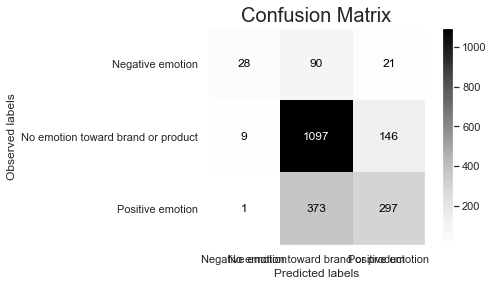

In [99]:
#Plot a confusion matric on actual and preditions of the test data.
ax = plt.subplot()
sns.set(font_scale=1) # Adjust to fit

plot_confusion_matrix(rf, X_test_vec, y_test, ax=ax,  cmap = plt.cm.Greys)

# Labels, title and ticks
label_font = {'size':'12'}  # Adjust to fit
ax.set_xlabel('Predicted labels', fontdict=label_font);
ax.set_ylabel('Observed labels', fontdict=label_font);
ax.grid(b=False);

title_font = {'size':'20'}  # Adjust to fit
ax.set_title('Confusion Matrix', fontdict=title_font);

plt.savefig('ConfusionMatrix_Multi1.png')

plt.show()

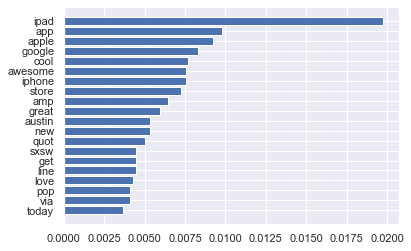

In [100]:
#if rf model is select, can order feature importances

importances = sorted(list(zip(rf.feature_importances_,tfidf.get_feature_names())))[-20:]
impts = pd.DataFrame(importances, columns=['impt','feature'])
plt.barh(impts.feature,impts.impt)
plt.savefig('Word_importance.png');

# 4. NLP Model - Multi Classification (Google vs Apple: Positive, Negative and None)

In [101]:
df_company_emotion= df.dropna(subset=['class_company_emotion'])
df_company_emotion['company'].value_counts()


Apple     4903
Google    2614
na         731
Name: company, dtype: int64

In [59]:
df_company_emotion.head()

,tweet,product,emotion,company,binary_emotion,class_emotion,class_company_emotion,clean_tweet,count
5,@teachntech00 new ipad apps for #speechtherapy and communication are showcased at the #sxsw conference http://ht.ly/49n4m #iear #edchat #asd,NaN,No emotion toward brand or product,Apple,2,0,All other,new ipad apps for and communication are showcased at the conference http ht ly 49n4m,1
8,beautifully smart and simple idea rt @madebymany @thenextweb wrote about our #hollergram ipad app for #sxsw! http://bit.ly/ieavob,iPad or iPhone App,Positive emotion,Apple,1,1,All other,beautifully sma and simple idea wrote about our ipad app for http bit ly ieavob,1
11,find &amp; start impromptu parties at #sxsw with @hurricaneparty http://bit.ly/gvlrin i can't wait til the android app comes out.,Android App,Positive emotion,Google,1,1,All other,find amp sta impromptu paies at with http bit ly gvlrin i can't wait til the android app comes out,1
12,"foursquare ups the game, just in time for #sxsw http://j.mp/grn7pk) - still prefer @gowalla by far, best looking android app to date.",Android App,Positive emotion,Google,1,1,All other,foursquare ups the game just in time for http j mp grn7pk still prefer by far best looking android app to date,1
13,gotta love this #sxsw google calendar featuring top parties/ show cases to check out. rt @hamsandwich via @ischafer =&gt;http://bit.ly/axzwxb,Other Google product or service,Positive emotion,Google,1,1,All other,gotta love this google calendar featuring top paies show cases to check out via gt http bit ly axzwxb,1


In [102]:
X3 = df_company_emotion['clean_tweet']
y3 = df_company_emotion['class_company_emotion']

X_train, X_test, y_train, y_test = train_test_split(X3,
                                                    y3,
                                                    random_state=42,
                                                    test_size=0.25)

In [103]:
X_train_tokenized3 = [tweet_preparer(tweet, sw) for tweet in X_train]

In [62]:
run_pipelines_cv(X_train_tokenized3, y_train)

CV Results for `cv_dummy_model` model:
            0.93324 ± 0.00071 accuracy
        
CV Results for `cv_dt_model` model:
            0.92289 ± 0.00612 accuracy
        
CV Results for `cv_mnb_model` model:
            0.93501 ± 0.00267 accuracy
        
CV Results for `cv_rf_model` model:
            0.93986 ± 0.00268 accuracy
        
CV Results for `cv_knn_model` model:
            0.93518 ± 0.00245 accuracy
        
CV Results for `tfidf_dummy_model` model:
            0.93324 ± 0.00071 accuracy
        
CV Results for `tfidf_dt_model` model:
            0.91869 ± 0.00880 accuracy
        
CV Results for `tfidf_mnb_model` model:
            0.93324 ± 0.00071 accuracy
        
CV Results for `tfidf_rf_model` model:
            0.93987 ± 0.00327 accuracy
        
CV Results for `tfidf_knn_model` model:
            0.93534 ± 0.00270 accuracy
        
None None None None None None None None None None


### Apply Grid Search and Identify Best Score and Best Parameters

In [63]:
 run_gridsearch(X_train_tokenized3, y_train)

cv_rf: {'cv__max_df': 0.9, 'cv__max_features': None, 'cv__ngram_range': (1, 1), 'rf__criterion': 'gini', 'rf__max_depth': None, 'rf__min_samples_leaf': 1} 0.9382474667070653
cv_mnb:  {'cv__max_df': 0.5, 'cv__max_features': None, 'cv__ngram_range': (1, 2), 'mnb__alpha': 0.7} 0.9388944538548236
tfidf_rf: {'rf__criterion': 'gini', 'rf__max_depth': None, 'rf__min_samples_leaf': 1, 'tfidf__norm': 'l2', 'tfidf__use_idf': True} 0.9385709602809446


Based on the results of the grid searches applied above, the cv_mnb_model model with a best accuracy score of .942 is the final model for this binary prediction.

### Final Multi Class (6 classes) NLP Model

In [104]:
tfidf = TfidfVectorizer(norm='l2', use_idf = True)
X_train_vec = cv.fit_transform(X_train_tokenized3)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(cv.vocabulary_)
X_train_vec.set_index(y_train.index, inplace=True)


X_test_tokens = [tweet_preparer(tweet, sw) for tweet in X_test]
X_test_tokens_vec = cv.transform(X_test_tokens)
X_test_vec  = pd.DataFrame.sparse.from_spmatrix(X_test_tokens_vec)
X_test_vec.columns = sorted(cv.vocabulary_)
X_test_vec.set_index(y_test.index, inplace=True)

rf = RandomForestClassifier(criterion='gini',max_depth = None, min_samples_leaf = 1)
rf.fit(X_train_vec, y_train)

y_train_hat = rf.predict(X_train_vec)
y_test_hat = rf.predict(X_test_tokens_vec)

accuracy_score(y_test, y_test_hat)

0.9437439379243453

In [105]:
print('y_test:' + classification_report(y_test, y_test_hat))

y_test:                         precision    recall  f1-score   support

              All other       0.95      0.99      0.97      1924
 Negative Emotion Apple       0.77      0.25      0.37        93
Negative Emotion Google       0.71      0.22      0.34        45

               accuracy                           0.94      2062
              macro avg       0.81      0.49      0.56      2062
           weighted avg       0.93      0.94      0.93      2062



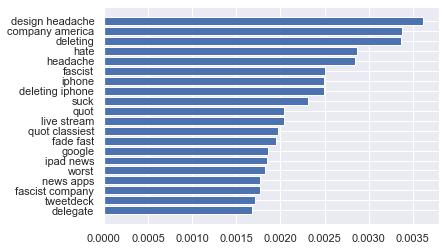

In [75]:
importances = sorted(list(zip(rf.feature_importances_,cv.get_feature_names())))[-20:]
impts = pd.DataFrame(importances, columns=['impt','feature'])
plt.barh(impts.feature,impts.impt);

# 7. Recommendations / Next Steps

Based on the results of the final models, here are my recommendations:
    
    1. At the end of each weekly or two-week period, feed NLP model with Tweet data from multiple regions or events (e.g. #sxsw = South by Southwest)

    2. Focus on quantity of negative emotion to Apple or Google products that are identified by the model

    3. Setup temporary ‘Google’ branded (Android, etc.) advertisements, ‘give aways’ or other campaigns at the event





If given additional time, consider:

    - Further tune the model to increase the overall accuracy score

    - Continue to add tweet data each week and update model
    
    - Consider more advanced NLP models (word embeddings, context, etc.)